# Example usage

## Initialize a GeslaDataset object
Place the `gesla.py` file in your working directory (or elsewhere on your path), and import the `GeslaDataset` class. Selecting and loading data files requires paths to the metadata .csv file and the directory containing the data files. Initialize a `GeslaDataset` object with these paths as follows.

In [1]:
from gesla import GeslaDataset
import logging
import pandas as pd
import numpy as np

import shapely
import geopandas as gpd
import matplotlib.pyplot as plt
import cartopy.feature as cf
import geopandas as gp
import xarray as xr

from searvey import ioc
from searvey.coops import coops_stations


In [2]:
%matplotlib widget

In [3]:
# whole catalog
catalog = pd.read_csv('catalog_new.csv',index_col=0)
catalog.loc[~catalog.nws_id.isna()] # these can be downloaded from COOPS
catalog.loc[~catalog.EP_PLATFORM_ID.isna()] # these can be downloaded from emodnet
catalog.loc[~catalog.institution_edmo_code.isna()] # these can be downloaded from cmems
catalog


,Station_Name,ioc_code,gloss_id,latitude,longitude,Country,connection,contacts,dcp_id,last_observation_level,...,start_date_time,end_date_time,number_of_years,time_zone_hours,datum_information,instrument,precision,null_value,gauge_type,overall_record_quality
0,A Coru\u00f1a 2 tide gauge,NaN,NaN,43.357000,-8.389000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,A Coru\u00f1a ACOR1 TG tide gauge,NaN,NaN,43.364400,-8.398900,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,A Coruña,acor1,NaN,43.364000,-8.399000,Spain,web,Instituto Geográfico Nacional ( Spain ),NaN,4.27,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,A121,NaN,NaN,55.400002,3.810000,NLD,NaN,NaN,NaN,NaN,...,2015-06-28 00:00:00,2020-10-06 07:40:00,6.0,0.0,MSL,Unspecified,Unspecified,-99.9999,Coastal,No obvious issues
4,A2,NaN,NaN,51.360600,3.118330,BEL,NaN,NaN,NaN,NaN,...,2020-02-28 00:00:00,2021-01-12 08:55:00,2.0,0.0,MSL,Unspecified,Unspecified,-99.9999,Coastal,No obvious issues
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6096,\u00d6lands norra udd,NaN,NaN,57.366100,17.097200,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6097,papho,NaN,NaN,34.755100,32.408798,CYP,NaN,NaN,NaN,NaN,...,2014-11-01 00:00:00,2016-08-26 01:00:00,3.0,0.0,Unknown,Unspecified,Unspecified,-99.9999,Coastal,Possible quality control issues
6098,s_Gravendeel,NaN,NaN,51.779151,4.625854,NLD,NaN,NaN,NaN,NaN,...,1970-10-30 07:00:00,1983-12-31 22:00:00,14.0,0.0,Normal Amsterdam Level,Unspecified,Unspecified,-99.9999,River,No obvious issues
6099,s_Gravendeel_haven,NaN,NaN,51.782206,4.625803,NLD,NaN,NaN,NaN,NaN,...,1983-12-31 23:00:00,1992-12-31 22:50:00,10.0,0.0,Normal Amsterdam Level,Unspecified,Unspecified,-99.9999,River,No obvious issues


# IOC DATABASE

In [4]:
ioc_stations = catalog.loc[~catalog.ioc_code.isna()] # these can be downloaded from IOC
ioc_stations

,Station_Name,ioc_code,gloss_id,latitude,longitude,Country,connection,contacts,dcp_id,last_observation_level,...,start_date_time,end_date_time,number_of_years,time_zone_hours,datum_information,instrument,precision,null_value,gauge_type,overall_record_quality
2,A Coruña,acor1,NaN,43.364,-8.399,Spain,web,Instituto Geográfico Nacional ( Spain ),NaN,4.27,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,Abashiri,abas,327.0,44.020,144.290,Japan,SWJP40,Japan Meteorological Agency ( Japan ),ABASHIRI,2.15,...,1968-01-01 00:00:00,2018-12-31 14:00:00,51.0,0.0,Unspecified,Unspecified,Unspecified,-99.9999,Coastal,No obvious issues
15,Aberdeen,abed,NaN,57.140,-2.080,UK,ftp,National Oceanography Centre ( UK ),NaN,2.45,...,1930-01-01 00:00:00,2021-07-31 23:45:00,73.0,0.0,Admiralty Chart Datum (ACD),bubbler,0.001 (m),-99.9999,Coastal,No obvious issues
20,Aburatsu,abur,82.0,31.580,131.410,Japan,SWJP40,Japan Meteorological Agency ( Japan ),ABURATSU,3.13,...,1961-01-01 00:00:00,2018-12-31 14:00:00,58.0,0.0,Unspecified,Unspecified,Unspecified,-99.9999,Coastal,No obvious issues
23,Acajutla,acaj,182.0,13.574,-89.838,El Salvador,SZXX01,Ministerio de Medio Ambiente y Recursos Natura...,300434064008810,6.99,...,1962-07-18 05:00:00,2001-07-31 23:00:00,40.0,0.0,Unspecified,Unspecified,Unspecified,-99.9999,Coastal,No obvious issues
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6085,Zhapo,zhap,78.0,21.580,111.820,China,SZCI01,China Meteorological Administration ( China ),09731,0.73,...,1975-01-01 00:00:00,1997-12-31 15:00:00,23.0,0.0,Unspecified,Unspecified,Unspecified,-99.9999,Coastal,No obvious issues
6088,"Zihuatanejo, Gro",zihu,NaN,17.637,-101.558,Mexico,ftp,Universidad Nacional Autónoma de México ( Mexi...,NaN,3.07,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6089,Zihuatanejo2,zihu2,NaN,17.636,-101.558,Mexico,SOMX10,Universidad Nacional Autónoma de México ( Mexi...,0102D23E,3.12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6095,Zygi,zygi,NaN,34.727,33.338,Cyprus,ftp,Cyprus Oceanography Center ( Cyprus ),ZYGI1,1.91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# GESLA3 DATABASE

In [5]:
META_FILE = "./GESLA3_ALL.csv"
GESLA_DATA_PATH = "/home/tomsail/Documents/scripts/Python/GeslaDataset/GESLA3.0_ALL/"
g3 = GeslaDataset(meta_file=META_FILE, data_path=GESLA_DATA_PATH)

## Load data from a single file
If you want to work with data from a single record, and you know the filename you want, use the function `file_to_pandas` as follows. The function returns a `pandas.DataFrame` with data and flags, and a `pandas.Series` containing metadata.

## In common between IOC and GESLA3

In [41]:
commonIOC_GESLA = catalog[~catalog.overall_record_quality.isna()&~catalog.ioc_code.isna()]
commonIOC_GESLA

,Station_Name,ioc_code,gloss_id,latitude,longitude,Country,connection,contacts,dcp_id,last_observation_level,...,start_date_time,end_date_time,number_of_years,time_zone_hours,datum_information,instrument,precision,null_value,gauge_type,overall_record_quality
102,Alicante2,alac2,NaN,38.339,-0.481,Spain,web,Instituto Geográfico Nacional ( Spain ),NaN,1.98,...,2019-11-01 00:00:00,2021-01-31 23:50:00,3.0,0.0,Geodetic Datum,Unspecified,Unspecified,-99.9999,Coastal,No obvious issues


## take a random station


In [43]:
test = commonIOC_GESLA.iloc[[int(np.floor(np.random.random() *len(commonIOC_GESLA)))]]
test

,Station_Name,ioc_code,gloss_id,latitude,longitude,Country,connection,contacts,dcp_id,last_observation_level,...,start_date_time,end_date_time,number_of_years,time_zone_hours,datum_information,instrument,precision,null_value,gauge_type,overall_record_quality
3492,Nagasaki,naga,83.0,32.74,129.87,Japan,SWJP40,Japan Meteorological Agency ( Japan ),NAGASAKI,3.29,...,1985-01-01 00:00:00,2018-12-31 14:00:00,34.0,0.0,Unspecified,Unspecified,Unspecified,-99.9999,Coastal,No obvious issues


In [47]:
ioc_request = test.rename(columns={'longitude':'lon','latitude':'lat','Country':'country','Station_Name':'location'})
data = ioc.get_ioc_data(
    ioc_metadata=ioc_request,
    endtime="2023-07-30",
    period=30,
)
data

      location ioc_code  gloss_id    lat     lon country connection  \
3492  Nagasaki     naga      83.0  32.74  129.87   Japan     SWJP40   

                                   contacts    dcp_id  last_observation_level  \
3492  Japan Meteorological Agency ( Japan )  NAGASAKI                    3.29   

      ...      start_date_time        end_date_time number_of_years  \
3492  ...  1985-01-01 00:00:00  2018-12-31 14:00:00            34.0   

     time_zone_hours datum_information   instrument    precision null_value  \
3492             0.0       Unspecified  Unspecified  Unspecified   -99.9999   

      gauge_type  overall_record_quality  
3492     Coastal       No obvious issues  

[1 rows x 71 columns]


100%|██████████| 1/1 [00:03<00:00,  3.41s/it]


<xarray.Dataset>
Dimensions:   (ioc_code: 1, time: 43031)
Coordinates:
  * ioc_code  (ioc_code) object 'naga'
  * time      (time) datetime64[ns] 2023-06-30 ... 2023-07-30
Data variables:
    rad       (ioc_code, time) float64 1.938 1.926 1.92 ... 1.935 1.923 1.917
    lon       (ioc_code) float64 129.9
    lat       (ioc_code) float64 32.74
    country   (ioc_code) object 'Japan'
    location  (ioc_code) object 'Nagasaki'

In [48]:
data = data.to_dataframe().reset_index(level= 'ioc_code',drop=True)
data = data.rename(columns={'rad':'slev','lon':'longitude','lat':'latitude','country':'Country','location':'Station_Name'})
data = data['slev']
data

time
2023-06-30 00:00:00    1.9385
2023-06-30 00:01:00    1.9263
2023-06-30 00:02:00    1.9202
2023-06-30 00:03:00    1.9141
2023-06-30 00:04:00    1.9080
                        ...  
2023-07-29 23:56:00    1.9629
2023-07-29 23:57:00    1.9477
2023-07-29 23:58:00    1.9355
2023-07-29 23:59:00    1.9233
2023-07-30 00:00:00    1.9172
Name: slev, Length: 43031, dtype: float64

In [57]:
print(test.filename.values)
data, meta = g3.file_to_pandas(test.filename.values[0])
a = plt.gca()
data.where(data.use_flag==1).sea_level.plot(ax=a)

['nagasaki-362a-jpn-uhslc']


<Axes: xlabel='date_time'>

In [ ]:
cmems.plot.scatter(x = 'Longitude', y = 'Latitude', marker='o', label='cmems')
a = plt.gca()
emodnet.plot.scatter(ax=a, x = 'Longitude', y = 'Latitude', color='orange', marker='1', label='emodnet')
ioc_stations.plot.scatter(ax=a, x = 'Longitude', y = 'Latitude', color='green', marker='x', label='ioc')
coops.plot.scatter(ax=a, x = 'Longitude', y = 'Latitude', color='cyan', marker='+', label='coops')
gesla3.plot.scatter(ax=a, x = 'Longitude', y = 'Latitude', color='red', marker='.',label='gesla')
plt.legend(loc='upper center',bbox_to_anchor=(.5, 1.1), ncol=5)

## Retrieve station offshore

In [3]:
gh = cf.GSHHSFeature(scale="intermediate", levels=[1])
wo = gp.GeoDataFrame(geometry=[x for x in gh.geometries()])

BUFFER_SIZE = 0.05

coords = ((-180.,-90.), (-180., 90.), (180., 90.), (180.,-90.), (-180.,-90.))
polygon = shapely.Polygon(coords)

coast_buffer = shapely.ops.unary_union(wo.geometry.buffer(BUFFER_SIZE))

offshore = polygon.difference(coast_buffer)
offshore

In [4]:
data = g3.load_lat_lon_range(offshore)

/home/tomsail/Documents/scripts/Python/GeslaDataset/gesla.py:75: UserWarning: Duplicate timestamps in file rothera-rot-gbr-noc were removed.
  warnings.warn(
/home/tomsail/Documents/scripts/Python/GeslaDataset/gesla.py:75: UserWarning: Duplicate timestamps in file lichteiland_goeree-lichtelgre-nld-rws were removed.
  warnings.warn(


In [5]:
data

<xarray.Dataset>
Dimensions:                  (date_time: 3764392, station: 119)
Coordinates:
  * date_time                (date_time) datetime64[ns] 1952-05-01T15:00:00 ....
  * station                  (station) int64 0 1 2 3 4 5 ... 114 115 116 117 118
Data variables: (12/27)
    sea_level                (station, date_time) float64 nan nan ... nan nan
    qc_flag                  (station, date_time) float64 nan nan ... nan nan
    use_flag                 (station, date_time) float64 nan nan ... nan nan
    filename                 (station) object 'faraday-700a-ata-uhslc' ... 'a...
    site_name                (station) object 'Faraday' ... 'Alboran'
    site_code                (station) object '700A' '749A' ... 'Oos' 'Alb'
    ...                       ...
    datum_information        (station) object 'Unspecified' ... 'Geodetic Datum'
    instrument               (station) object 'Unspecified' ... 'Unspecified'
    precision                (station) object 'Unspecified' ... 'Unspecified'
    null_value               (station) float64 -100.0 -100.0 ... -100.0 -100.0
    gauge_type               (station) object 'Coastal' 'Coastal' ... 'Coastal'
    overall_record_quality   (station) object 'No obvious issues' ... 'No obv...

/tmp/ipykernel_89427/1330263385.py:4: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  countries = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


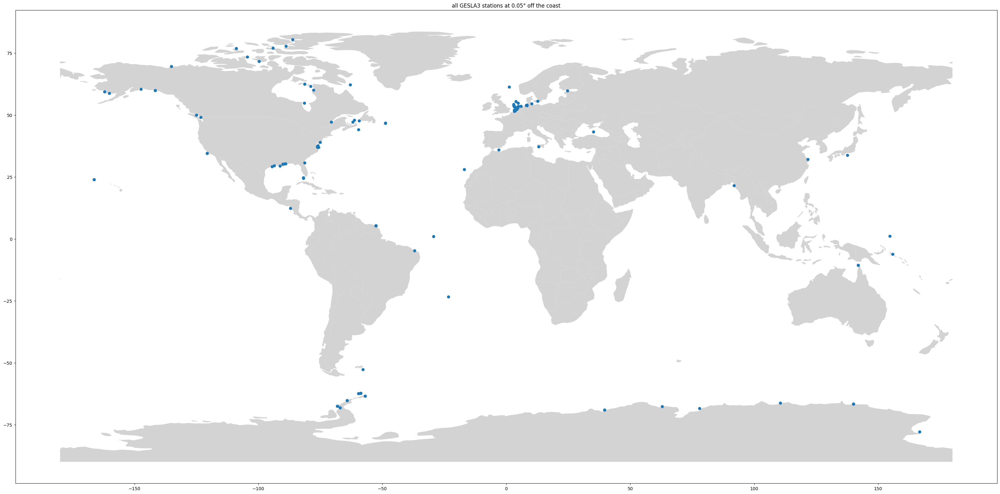

In [6]:
figure, axis = plt.subplots(1, 1)
figure.set_size_inches(40, 40 / 1.61803398875)

countries = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
_ = countries.plot(color='lightgrey', ax=axis, zorder=-1)
_ = axis.scatter(data.longitude, data.latitude)
_ = axis.set_title(f'all GESLA3 stations at '+str(BUFFER_SIZE)+'° off the coast')

# Keep only the stations with the flag: 'no obvious issue'

In [7]:
data = data.where(data.overall_record_quality == 'No obvious issues',drop=True)
data

<xarray.Dataset>
Dimensions:                  (station: 108, date_time: 3764392)
Coordinates:
  * date_time                (date_time) datetime64[ns] 1952-05-01T15:00:00 ....
  * station                  (station) int64 0 1 2 3 4 5 ... 114 115 116 117 118
Data variables: (12/27)
    sea_level                (station, date_time) float64 nan nan ... nan nan
    qc_flag                  (station, date_time) float64 nan nan ... nan nan
    use_flag                 (station, date_time) float64 nan nan ... nan nan
    filename                 (station) object 'faraday-700a-ata-uhslc' ... 'a...
    site_name                (station) object 'Faraday' ... 'Alboran'
    site_code                (station) object '700A' '749A' ... 'Oos' 'Alb'
    ...                       ...
    datum_information        (station) object 'Unspecified' ... 'Geodetic Datum'
    instrument               (station) object 'Unspecified' ... 'Unspecified'
    precision                (station) object 'Unspecified' ... 'Unspecified'
    null_value               (station) float64 -100.0 -100.0 ... -100.0 -100.0
    gauge_type               (station) object 'Coastal' 'Coastal' ... 'Coastal'
    overall_record_quality   (station) object 'No obvious issues' ... 'No obv...

# Plot in a table all the graphs

type: index 108 is out of bounds for axis 0 with size 108

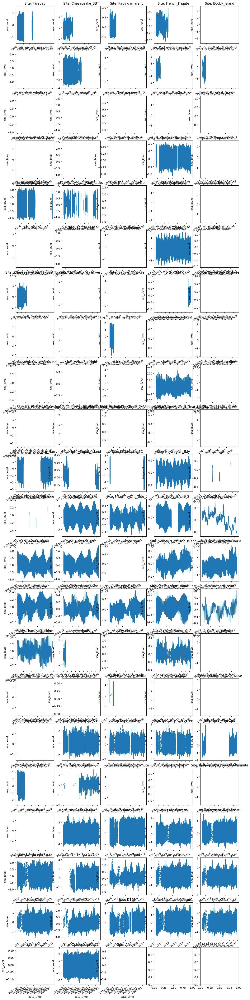

In [22]:
COL = 5
Y = int(np.ceil(len(data.station)/COL))
# Y = int(np.ceil(10/COL))
fig, axes = plt.subplots(Y,COL,figsize=(3*COL,3*Y))

for i, ax in enumerate(axes.flat):
    arr = data.sea_level[i].where(data.use_flag[i]==1)
    arr = arr - arr.mean()
    arr.plot(ax=ax)
    ax.set_title("Site: %s" % data.site_name[i].values)
plt.tight_layout()